# Analyzing Property Transaction Prices in Hong Kong

# Load packages:

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import plotly.express as px
from sklearn.linear_model import LinearRegression
from sklearn.metrics import r2_score, mean_absolute_error, mean_squared_error
import warnings
warnings.filterwarnings("ignore")

# Import and clean data

The **hw.csv** file contains Property Transaction price of Kowloon between Nov 2014 to Nov 2020. The data was extracted from the "District Latest Deals" from https://data.28hse.com/en/

1. Create a pandas dataframe from the data file
2. Clean up the data (i.e. handle NA value)
3. Drop column that is not useful
4. Rename column to a more meaningful name
5. Make sure the transaction date's data type is numpy datetime

In [2]:
# Import and create dataframe (df)
df = pd.read_csv('hw.csv', index_col=0, parse_dates=True)

In [3]:
# Innitial view of dataset (df1)
df.head(2)

,withpre,id,rootid,fatherid,catid,catname,catfathername,url_father,url_cat,source,...,sq_actprice_value,month,day,date_dm,date_y,block,state,floor,room,addr
date,,,,,,,,,,,,,,,,,,,,,
2020-11-27,1.0,683333,2,79,2058,Bel Air Heights,Diamond Hill,https://data.28hse.com/en/kl/diamond-hill,https://data.28hse.com/en/kl/diamond-hill/2058...,Land Registry,...,15220.7,Nov,27,27-Nov,2020,BLOCK 2,None,2#,E,BLOCK 2 2#/F Room E
2020-11-27,1.0,683332,2,71,2712,Fa Yuen Plaza,Mong Kok,https://data.28hse.com/en/kl/mong-kok,https://data.28hse.com/en/kl/mong-kok/2712_fa-...,Land Registry,...,20000.0,Nov,27,27-Nov,2020,None,None,1#,C,1#/F Room C


In [4]:
# Lets make a copy of the df
df1=df.copy()
df1.tail()

,withpre,id,rootid,fatherid,catid,catname,catfathername,url_father,url_cat,source,...,sq_actprice_value,month,day,date_dm,date_y,block,state,floor,room,addr
date,,,,,,,,,,,,,,,,,,,,,
2014-10-27,1.0,550352,2,56,2081,Amoy Gardens,Kowloon Bay,https://data.28hse.com/en/kl/kowloon-bay,https://data.28hse.com/en/kl/kowloon-bay/2081_...,NaN,...,11125.32,Oct,27,27-Oct,2014,BLOCK H,None,2#,6,BLOCK H 2#/F Room 6
2014-10-27,1.0,550351,2,59,2178,Marple Court,Kowloon Tong,https://data.28hse.com/en/kl/kowloon-tong,https://data.28hse.com/en/kl/kowloon-tong/2178...,NaN,...,11061.95,Oct,27,27-Oct,2014,None,None,9,D,9/F Room D
2014-10-27,1.0,550350,2,75,3061,Harbour Place,Hung Hom,https://data.28hse.com/en/kl/hung-hom,https://data.28hse.com/en/kl/hung-hom/3061_har...,NaN,...,13513.51,Oct,27,27-Oct,2014,TOWER 7,None,4,E,TOWER 7 4/F Room E
2014-10-27,1.0,550349,2,56,2082,Richland Gardens,Kowloon Bay,https://data.28hse.com/en/kl/kowloon-bay,https://data.28hse.com/en/kl/kowloon-bay/2082_...,NaN,...,0.00,Oct,27,27-Oct,2014,BLOCK 13,None,1#,B,BLOCK 13 1#/F Room B
2014-10-27,1.0,550348,2,74,2950,The Victoria Towers,Tsim Sha Tsui,https://data.28hse.com/en/kl/tsim-sha-tsui,https://data.28hse.com/en/kl/tsim-sha-tsui/295...,NaN,...,6493.51,Oct,27,27-Oct,2014,TOWER 3,None,3#,D,TOWER 3 3#/F Room D


In [5]:
# Check number of rows and columns
df1.shape

(80000, 33)

In [6]:
# Check the date type
type(df1.index) 

pandas.core.indexes.datetimes.DatetimeIndex

In [7]:
df1.dtypes

withpre              float64
id                     int64
rootid                 int64
fatherid               int64
catid                  int64
catname               object
catfathername         object
url_father            object
url_cat               object
source                object
contract              object
memo                 float64
price                 object
price_value            int64
holddate              object
winloss_flag           int64
winloss               object
act_area              object
area                  object
arearaw               object
sq_price              object
sq_price_value       float64
sq_actprice           object
sq_actprice_value    float64
month                 object
day                    int64
date_dm               object
date_y                 int64
block                 object
state                 object
floor                 object
room                  object
addr                  object
dtype: object

In [8]:
# Drop not useful columns
df1=df1.drop(columns=['id','rootid', 'url_father','url_cat',
                      'source', 'contract','memo','price',
                      'month', 'day','date_dm', 'date_y',
                      'block','state','room','addr','area'])           

In [9]:
# Dropped 16 (33-17) columns
df1.shape

(80000, 16)

In [10]:
# Rename columns with more friendly names
df1.rename(columns = {'withpre':'Previous Transaction Flag',
                      'catfathername':'District Name', 
                      'fatherid':'District ID',
                      'catname':'Estate Name',
                      'catid':'Estate ID',
                      'price_value':'Sell Price', 
                      'holddate':'Hold Time (in days)',
                      'winloss_flag':'Change flag',
                      'winloss':'% Change',
                      'act_area':'SFA',
                      'arearaw':'GFA',
                      'sq_price':'GFA Price',
                      'sq_actprice':'SFA Price',
                      'sq_actprice_value': 'SFA_Price_Value',
                      "sq_price_value":'GFA_Price_Value'}, inplace = True)

In [11]:
# List column names
for col in df1.columns: 
    print(col) 

Previous Transaction Flag
District ID
Estate ID
Estate Name
District Name
Sell Price
Hold Time (in days)
Change flag
% Change
SFA
GFA
GFA Price
GFA_Price_Value
SFA Price
SFA_Price_Value
floor


In [12]:
# Remove "ft<sup>2</sup>" from SFA
df1['SFA'] = df1['SFA'].str.replace('ft<sup>2</sup>', '')

# Check:
df1['SFA']

date
2020-11-27    657
2020-11-27    214
2020-11-27    991
2020-11-27     --
2020-11-27    412
             ... 
2014-10-27    391
2014-10-27    678
2014-10-27    481
2014-10-27     --
2014-10-27    924
Name: SFA, Length: 80000, dtype: object

In [13]:
df1.dtypes

Previous Transaction Flag    float64
District ID                    int64
Estate ID                      int64
Estate Name                   object
District Name                 object
Sell Price                     int64
Hold Time (in days)           object
Change flag                    int64
% Change                      object
SFA                           object
GFA                           object
GFA Price                     object
GFA_Price_Value              float64
SFA Price                     object
SFA_Price_Value              float64
floor                         object
dtype: object

In [14]:
# Remove "--" from column "Hold Time (in days)"
df1['Hold Time (in days)'] = df1['Hold Time (in days)'].replace('--','0 years 0 days')

In [15]:
# Modify Hold Time column from "years, days" to "number of days" only

w= ' 0 days'
for l in range(len(df1['Hold Time (in days)'])):
    if df1['Hold Time (in days)'][l].endswith('years'):
        df1['Hold Time (in days)'][l]=df1['Hold Time (in days)'][l]+w

In [16]:
# Transforms years into days
a=[] 
for i in range(len(df1['Hold Time (in days)'])):
    b=[]
    for s in df1['Hold Time (in days)'][i].split():
        if s.isdigit():
            b.append(int(s))
    if len(b) ==2:
        b=sum([b[0]*365,b[1]])
    elif len(b)==1:
        b=int(b[0])
    a.append(b)

In [17]:
# Assign block to dataframe
df1['Hold Time (in days)']=a

In [18]:
# Check if years/days were transformed into days
df1['Hold Time (in days)'].tail(3)

date
2014-10-27    2477
2014-10-27    2496
2014-10-27    4657
Name: Hold Time (in days), dtype: int64

In [19]:
# lets look at floor column
df1['floor'].head(3)

date
2020-11-27    2#
2020-11-27    1#
2020-11-27     7
Name: floor, dtype: object

In [20]:
# Clean up floor column by removing  "#"
df1['floor'] = df1['floor'].str.replace(r'\D', '')
# Double check 
df1['floor'].head(3)

date
2020-11-27    2
2020-11-27    1
2020-11-27    7
Name: floor, dtype: object

In [21]:
# Check DF
df1.head(2)

,Previous Transaction Flag,District ID,Estate ID,Estate Name,District Name,Sell Price,Hold Time (in days),Change flag,% Change,SFA,GFA,GFA Price,GFA_Price_Value,SFA Price,SFA_Price_Value,floor
date,,,,,,,,,,,,,,,,
2020-11-27,1.0,79,2058,Bel Air Heights,Diamond Hill,10000000,6091,1,413%,657,826,"$12,107",12106.54,"$15,221",15220.7,2
2020-11-27,1.0,71,2712,Fa Yuen Plaza,Mong Kok,4280000,1080,1,22%,214,347,"$12,334",12334.29,"$20,000",20000.0,1


In [22]:
# Clean up GFA and SFA Sell Price --> remove $
df1['GFA Price'] = df1['GFA Price'].str.replace(r'\D', '')
df1['SFA Price'] = df1['SFA Price'].str.replace(r'\D', '')
df1.head(2)

,Previous Transaction Flag,District ID,Estate ID,Estate Name,District Name,Sell Price,Hold Time (in days),Change flag,% Change,SFA,GFA,GFA Price,GFA_Price_Value,SFA Price,SFA_Price_Value,floor
date,,,,,,,,,,,,,,,,
2020-11-27,1.0,79,2058,Bel Air Heights,Diamond Hill,10000000,6091,1,413%,657,826,12107,12106.54,15221,15220.7,2
2020-11-27,1.0,71,2712,Fa Yuen Plaza,Mong Kok,4280000,1080,1,22%,214,347,12334,12334.29,20000,20000.0,1


In [23]:
# Checkpoint 1: save dataframe and all the work so far into a csv file for backup
df1.to_csv("Check_point_1.csv")

In [24]:
# lets check for Nulls
df1.isnull().sum()

Previous Transaction Flag    23564
District ID                      0
Estate ID                        0
Estate Name                      0
District Name                    0
Sell Price                       0
Hold Time (in days)              0
Change flag                      0
% Change                         0
SFA                              0
GFA                              0
GFA Price                        0
GFA_Price_Value                  0
SFA Price                        0
SFA_Price_Value                  0
floor                            0
dtype: int64

In [25]:
# Lets check for broader missing values in the dataframe besides nulls
# We can see number of columns need to be corrected
missing_values = ["n/a", "na", "--","None"]
df2=pd.read_csv("Check_point_1.csv", index_col=0, parse_dates=True,na_values = missing_values)
print (df2.isnull().sum())

Previous Transaction Flag    23564
District ID                      0
Estate ID                        0
Estate Name                      0
District Name                    0
Sell Price                       0
Hold Time (in days)              0
Change flag                      0
% Change                     25310
SFA                          41743
GFA                              4
GFA Price                    30508
GFA_Price_Value                  0
SFA Price                    41743
SFA_Price_Value                  0
floor                           32
dtype: int64


In [26]:
# Replace NA with zero`s for the following columns:
df2['Previous Transaction Flag']=df2['Previous Transaction Flag'].fillna(0)
df2['floor']=df2['floor'].fillna(0)
df2['% Change']=df2['% Change'].fillna(0)

In [27]:
# Replace nulls with District Average for SFA and GFA
df2['SFA'] = df2['SFA'].replace(0,np.nan)
df2['SFA'] = df2['SFA'].fillna(df2.groupby('District Name')['SFA'].transform('mean'))
df2['GFA'] = df2['GFA'].replace(0,np.nan)
df2['GFA'] = df2['GFA'].fillna(df2.groupby('District Name')['GFA'].transform('mean'))

In [28]:
# Kai Tak District---> replace missing values for the GFA with SFA
df2['SFA'] = df2['SFA'].fillna(0)
df2['GFA'] = df2['GFA'].fillna(0)
df2['SFA'] = np.where(df2['SFA'] == 0, df2['GFA'], df2['SFA'])
df2['GFA'] = np.where(df2['GFA'] == 0, df2['SFA'], df2['GFA'])

In [29]:
# Calculate new SFA Price and new GFA Price
df2['SFA New Price'] = round(df2['Sell Price'] / df2['SFA'])
df2['GFA New Price'] = round(df2['Sell Price'] / df2['GFA'])

In [30]:
# Drop columns we dont need anymore
df2=df2.drop(columns=['GFA Price',
                      'GFA_Price_Value',
                      'SFA Price',
                      'SFA_Price_Value']) 

In [31]:
# Round SFA, GFA, Floor
df2['SFA'] = round(df2['SFA'])
df2['GFA'] = round(df2['GFA'])
df2['floor'] = df2['floor'].astype(int)

In [32]:
# Add Hold Time in years
df2['Hold Time (in yrs)']= round(df2['Hold Time (in days)']/365,2)

In [33]:
# lets check - all solved as per below (all zeros):
print (df2.isnull().sum())

Previous Transaction Flag    0
District ID                  0
Estate ID                    0
Estate Name                  0
District Name                0
Sell Price                   0
Hold Time (in days)          0
Change flag                  0
% Change                     0
SFA                          0
GFA                          0
floor                        0
SFA New Price                0
GFA New Price                0
Hold Time (in yrs)           0
dtype: int64


In [34]:
# Check type:
df2.dtypes

Previous Transaction Flag    float64
District ID                    int64
Estate ID                      int64
Estate Name                   object
District Name                 object
Sell Price                     int64
Hold Time (in days)            int64
Change flag                    int64
% Change                      object
SFA                          float64
GFA                          float64
floor                          int32
SFA New Price                float64
GFA New Price                float64
Hold Time (in yrs)           float64
dtype: object

In [35]:
df2.head()

,Previous Transaction Flag,District ID,Estate ID,Estate Name,District Name,Sell Price,Hold Time (in days),Change flag,% Change,SFA,GFA,floor,SFA New Price,GFA New Price,Hold Time (in yrs)
date,,,,,,,,,,,,,,,
2020-11-27,1.0,79,2058,Bel Air Heights,Diamond Hill,10000000,6091,1,413%,657.0,826.0,2,15221.0,12107.0,16.69
2020-11-27,1.0,71,2712,Fa Yuen Plaza,Mong Kok,4280000,1080,1,22%,214.0,347.0,1,20000.0,12334.0,2.96
2020-11-27,1.0,78,3094,Caldecott Hill,Yau Yat Tsuen,11000000,2044,0,14%,991.0,1282.0,7,11100.0,8580.0,5.60
2020-11-27,0.0,57,5035,Pang Ching Court,Wong Tai Sin,4900000,0,-1,0,327.0,583.0,1,14986.0,8405.0,0.00
2020-11-27,1.0,67,2564,Metro Harbour View,Tai Kok Tsui,7150000,4537,1,198%,412.0,595.0,1,17354.0,12017.0,12.43


In [36]:
# Checkpoint 2: save dataframe and all the work so far into a csv file for backup and future use
df2.to_csv("Check_point_2.csv")

# Merging Data

Get economics data and merge with the property data set above.

In [37]:
# Import new dataset. Source: https://www.macrotrends.net/
new_data = pd.read_excel(r'new_dataset.xlsx',sheet_name = 'HK',index_col = 0)
new_data.head()

,Unemployment Rate,Unemployment Change,GDP(billion),GDP Per Capita,GDP Growth,Inflation Rate,Population,Population Growth,Birth Rate
year,,,,,,,,,
2019,0.0363,0.0073,$366.03,"$48,756",-0.0119,0.0286,7436154,0.0087,0.070
2018,0.0290,-0.0019,$361.69,"$48,543",0.0286,0.0241,7371730,0.0090,0.072
2017,0.0309,-0.0030,$341.24,"$46,166",0.0379,0.0148,7306322,0.0087,0.077
2016,0.0339,0.0007,$320.84,"$43,731",0.0217,0.0241,7243542,0.0080,0.083
2015,0.0332,0.0002,$309.38,"$42,432",0.0239,0.0300,7185996,0.0072,0.082


In [38]:
# Check index type of new dataset
type(new_data.index)

pandas.core.indexes.numeric.Int64Index

In [39]:
# Import data from Q1 and add time slicers (month, quarter, year) 
base_data = pd.read_csv('Check_point_2.csv')
base_data['date'] = pd.to_datetime(base_data['date'])
base_data['year'] = pd.DatetimeIndex(base_data['date']).year
base_data['month'] = pd.DatetimeIndex(base_data['date']).month
base_data['quarter'] = pd.DatetimeIndex(base_data['date']).quarter
# Checkpoint 3: save dataframe and all the work so far into a csv file for backup and future use
base_data.to_csv("Check_point_3.csv")

In [40]:
# Import data, index the date column, join the data and remove empty rows
base_data1 = pd.read_csv('Check_point_3.csv', index_col = 17)
# Remove unamed column
base_data1.drop(base_data1.filter(regex="Unname"),axis=1, inplace=True)
# Check
base_data1.head()

,date,Previous Transaction Flag,District ID,Estate ID,Estate Name,District Name,Sell Price,Hold Time (in days),Change flag,% Change,SFA,GFA,floor,SFA New Price,GFA New Price,Hold Time (in yrs),month,quarter
year,,,,,,,,,,,,,,,,,,
2020,2020-11-27,1.0,79,2058,Bel Air Heights,Diamond Hill,10000000,6091,1,413%,657.0,826.0,2,15221.0,12107.0,16.69,11,4
2020,2020-11-27,1.0,71,2712,Fa Yuen Plaza,Mong Kok,4280000,1080,1,22%,214.0,347.0,1,20000.0,12334.0,2.96,11,4
2020,2020-11-27,1.0,78,3094,Caldecott Hill,Yau Yat Tsuen,11000000,2044,0,14%,991.0,1282.0,7,11100.0,8580.0,5.60,11,4
2020,2020-11-27,0.0,57,5035,Pang Ching Court,Wong Tai Sin,4900000,0,-1,0,327.0,583.0,1,14986.0,8405.0,0.00,11,4
2020,2020-11-27,1.0,67,2564,Metro Harbour View,Tai Kok Tsui,7150000,4537,1,198%,412.0,595.0,1,17354.0,12017.0,12.43,11,4


In [41]:
# Join base_data1 and new_data
blend_data = base_data1.join(new_data)
# Remove year for which we dont have new data
blend_data = blend_data[blend_data.index != 2020]
# Check
blend_data.head()

,date,Previous Transaction Flag,District ID,Estate ID,Estate Name,District Name,Sell Price,Hold Time (in days),Change flag,% Change,...,quarter,Unemployment Rate,Unemployment Change,GDP(billion),GDP Per Capita,GDP Growth,Inflation Rate,Population,Population Growth,Birth Rate
year,,,,,,,,,,,,,,,,,,,,,
2014,2014-12-31,1.0,70,8442,Foo Kam Building,Prince Edward,2850000,762,1,36%,...,4,0.033,-0.001,$291.46,"$40,315",0.0276,0.0444,7134670.0,0.0065,0.086
2014,2014-12-31,0.0,75,7839,Berkeley Building,Hung Hom,2970000,0,-1,0,...,4,0.033,-0.001,$291.46,"$40,315",0.0276,0.0444,7134670.0,0.0065,0.086
2014,2014-12-31,1.0,73,7837,Sheung On Mansion,Jordan,3680000,1414,1,85%,...,4,0.033,-0.001,$291.46,"$40,315",0.0276,0.0444,7134670.0,0.0065,0.086
2014,2014-12-31,1.0,77,8895,Tung Po Building,To Kwa Wan,2980000,6063,1,231%,...,4,0.033,-0.001,$291.46,"$40,315",0.0276,0.0444,7134670.0,0.0065,0.086
2014,2014-12-31,0.0,62,7943,Sevilla Crest,Sham Shui Po,6445800,0,-1,0,...,4,0.033,-0.001,$291.46,"$40,315",0.0276,0.0444,7134670.0,0.0065,0.086


In [42]:
# Check for nulls
print(blend_data.isnull().sum())

date                         0
Previous Transaction Flag    0
District ID                  0
Estate ID                    0
Estate Name                  0
District Name                0
Sell Price                   0
Hold Time (in days)          0
Change flag                  0
% Change                     0
SFA                          0
GFA                          0
floor                        0
SFA New Price                0
GFA New Price                0
Hold Time (in yrs)           0
month                        0
quarter                      0
Unemployment Rate            0
Unemployment Change          0
GDP(billion)                 0
GDP Per Capita               0
GDP Growth                   0
Inflation Rate               0
Population                   0
Population Growth            0
Birth Rate                   0
dtype: int64


In [43]:
# Checkpoint 4: save blended/combined dataframe and all the work so far into a csv file for backup and future use
blend_data.to_csv("Check_point_4.csv")

# Data Aggregation

Create another dataframe with the monthly average unit price per district and further clean the data and missing values. Create second dataframe with the monthly average unit price per Estate.

In [44]:
# Lets create a new dataframe:
df3=pd.DataFrame(df2, columns= ['District Name','Estate Name',
                               'GFA New Price',
                               'SFA New Price',
                               'Sell Price'])

In [45]:
df3

,District Name,Estate Name,GFA New Price,SFA New Price,Sell Price
date,,,,,
2020-11-27,Diamond Hill,Bel Air Heights,12107.0,15221.0,10000000
2020-11-27,Mong Kok,Fa Yuen Plaza,12334.0,20000.0,4280000
2020-11-27,Yau Yat Tsuen,Caldecott Hill,8580.0,11100.0,11000000
2020-11-27,Wong Tai Sin,Pang Ching Court,8405.0,14986.0,4900000
2020-11-27,Tai Kok Tsui,Metro Harbour View,12017.0,17354.0,7150000
...,...,...,...,...,...
2014-10-27,Kowloon Bay,Amoy Gardens,8683.0,11125.0,4350000
2014-10-27,Kowloon Tong,Marple Court,8824.0,11062.0,7500000
2014-10-27,Hung Hom,Harbour Place,10317.0,13514.0,6500000


In [46]:
# Reset index
df4=df3.reset_index()
df4

,date,District Name,Estate Name,GFA New Price,SFA New Price,Sell Price
0,2020-11-27,Diamond Hill,Bel Air Heights,12107.0,15221.0,10000000
1,2020-11-27,Mong Kok,Fa Yuen Plaza,12334.0,20000.0,4280000
2,2020-11-27,Yau Yat Tsuen,Caldecott Hill,8580.0,11100.0,11000000
3,2020-11-27,Wong Tai Sin,Pang Ching Court,8405.0,14986.0,4900000
4,2020-11-27,Tai Kok Tsui,Metro Harbour View,12017.0,17354.0,7150000
...,...,...,...,...,...,...
79995,2014-10-27,Kowloon Bay,Amoy Gardens,8683.0,11125.0,4350000
79996,2014-10-27,Kowloon Tong,Marple Court,8824.0,11062.0,7500000
79997,2014-10-27,Hung Hom,Harbour Place,10317.0,13514.0,6500000
79998,2014-10-27,Kowloon Bay,Richland Gardens,8064.0,9717.0,3790000


In [47]:
# Check types
df4.dtypes

date             datetime64[ns]
District Name            object
Estate Name              object
GFA New Price           float64
SFA New Price           float64
Sell Price                int64
dtype: object

In [48]:
# Lets create two dataframes: one for District and second one for Estate:

monthly_avg_price_per_district=df4.groupby([df4['District Name'], 
                                df4['date'].dt.month]).aggregate([np.mean]).round(decimals=0)

monthly_avg_price_per_estate=df4.groupby([df4['Estate Name'], 
                                  df4['date'].dt.month,
                                  df4['District Name']]).aggregate([np.mean]).round(decimals=0)

In [49]:
monthly_avg_price_per_district.head()

GFA New Price SFA New Price Sell Price
                             mean          mean       mean
District Name  date                                       
Cheung Sha Wan 1          10050.0       10718.0  5113788.0
               2           8127.0       11021.0  4000500.0
               3           8873.0       10332.0  4401265.0
               4           9228.0       10941.0  4584974.0
               5           9165.0       12008.0  4712703.0

In [50]:
monthly_avg_price_per_estate.head()

GFA New Price SFA New Price   Sell Price
                                           mean          mean         mean
Estate Name    date District Name                                         
1 & 3 Ede Road 3    Kowloon Tong       170458.0       60951.0  209382500.0
               4    Kowloon Tong        48633.0       39367.0   59738667.0
               5    Kowloon Tong        47871.0       35947.0   58802000.0
               6    Kowloon Tong        56672.0       43680.0   69612500.0
               7    Kowloon Tong        45594.0       39748.0   56005000.0

In [51]:
# Lets export the dataframes as two seperate excel files for record keeping and future use:
monthly_avg_price_per_district.to_csv("month_avg_price_per_district.csv")
monthly_avg_price_per_estate.to_csv("month_avg_price_per_estate.csv")

# Data visualization

- Visualize the overall trend of property price of Kowloon.
- Select 5 districts and visualize the trend of their property price
- Select 10 estates and visualize the trend of their property price

### Q3-A: Visualize the overall trend of property price of Kowloon.

Text(0.5, 0, 'Date')

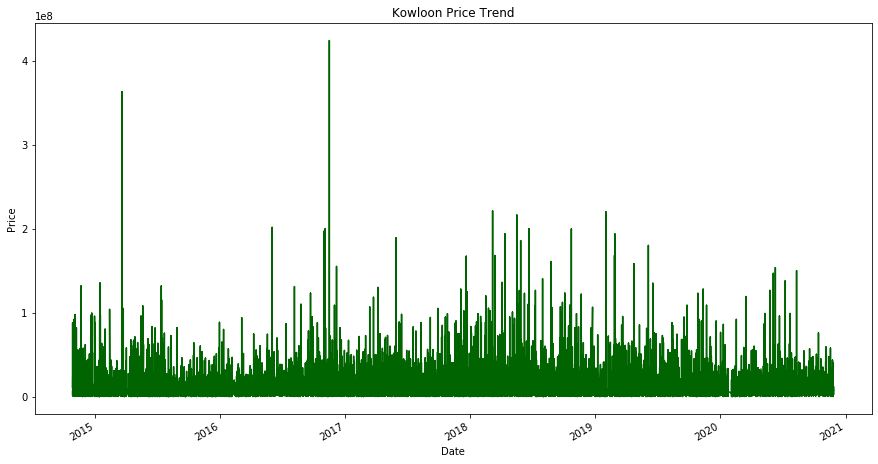

In [52]:
kowloon=df2

plt.figure(figsize=(15,8))
kowloon['Sell Price'].plot.line(color='darkgreen')
plt.title("Kowloon Price Trend")
plt.ylabel("Price")
plt.xlabel("Date")

In [53]:
import plotly.express as px
import pandas as pd

# Reset index on original dataframe to include "date" as a column and part of DF to chart dates as "x"
new_df=kowloon.copy()
new_df1=new_df.reset_index()
new_df1.columns=["data",'Previous Transaction Flag', 'District ID', 'Estate ID', 'Estate Name',
       'District Name', 'Sell Price', 'Hold Time (in days)', 'Change flag',
       '% Change', 'SFA', 'GFA', 'floor', 'SFA New Price', 'GFA New Price',
       'Hold Time (in yrs)']

# Interactive Chart with date slider at the bottom
df = new_df1
fig = px.line(df,x="data", y='Sell Price', title='Sell Price for Kowloon with Rangeslider')
fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()

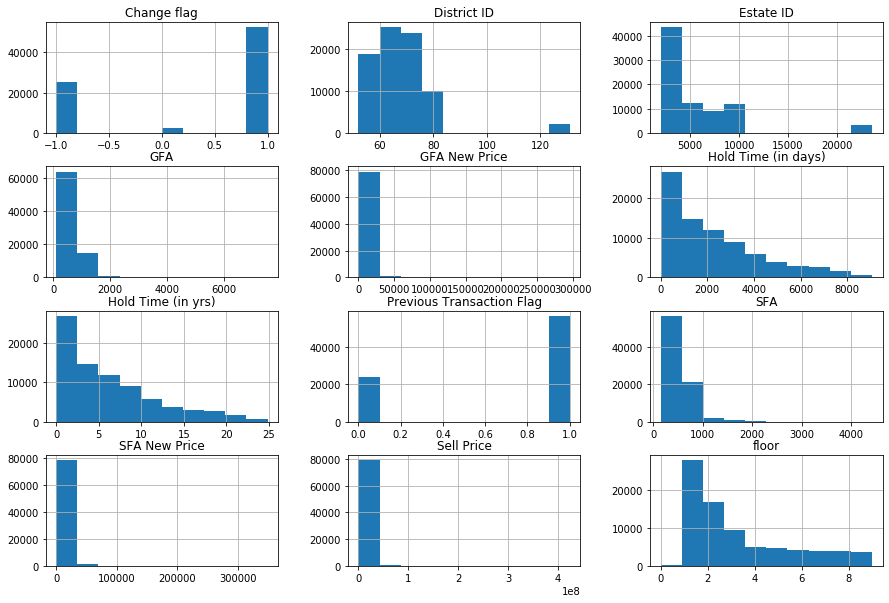

In [54]:
# Pandas Hist function
kowloon.hist(bins=10 , figsize=(15,10)) #Pandas Hist function
plt.show()

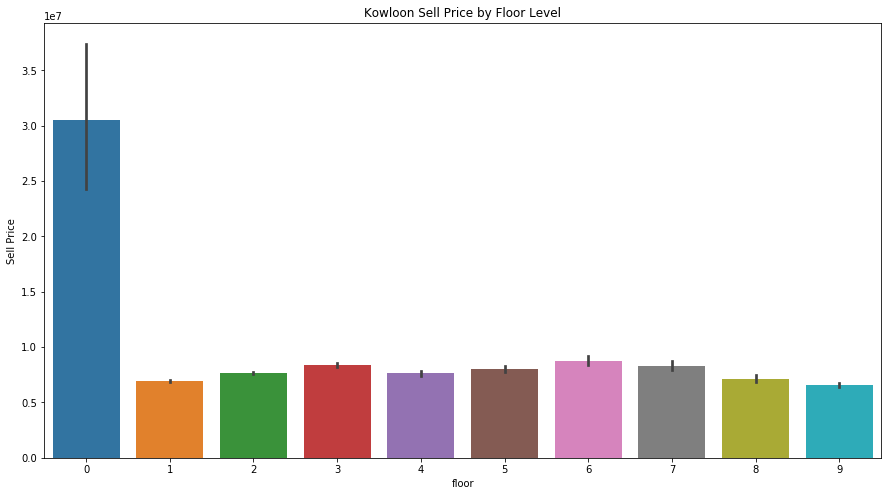

In [55]:
plt.figure(figsize=(15,8))
ax1 = sns.barplot(x="floor",y="Sell Price", 
                  data=kowloon).set_title("Kowloon Sell Price by Floor Level")

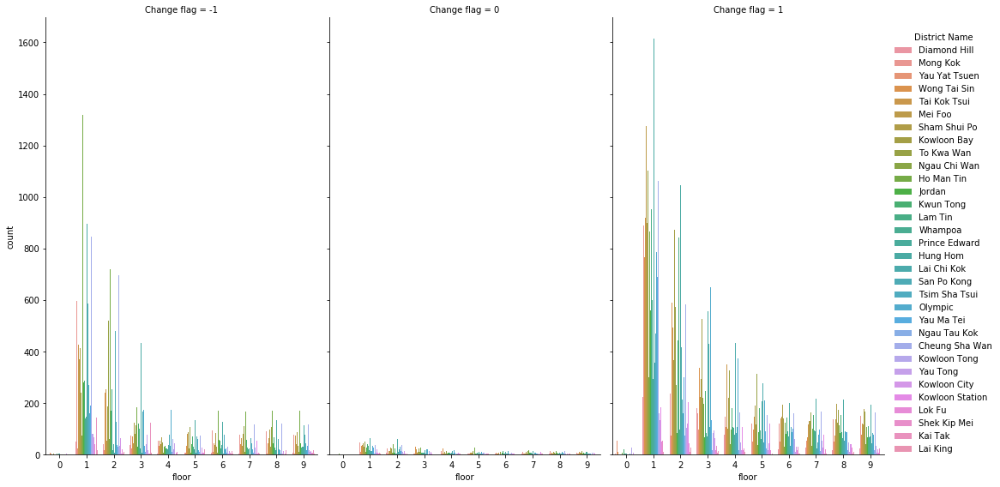

In [56]:
# Kowloon by Floor by District and by Transaction Flag (-1,0,1)

g = sns.catplot(x="floor", hue='District Name', 
                   col="Change flag", 
                   data=kowloon, 
                   kind="count",
               height=8, aspect=.6)

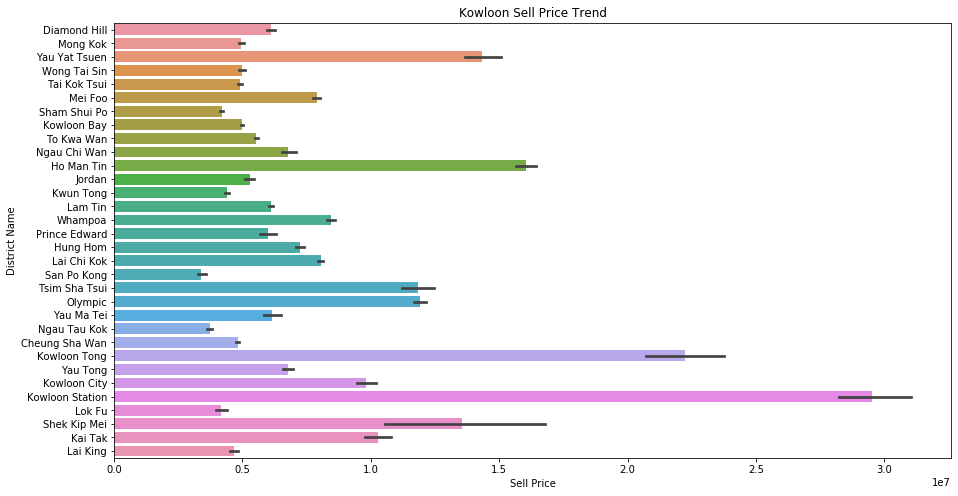

In [57]:
plt.figure(figsize=(15,8))
ax1 = sns.barplot(y="District Name",x="Sell Price", 
                  data=kowloon).set_title("Kowloon Sell Price Trend")

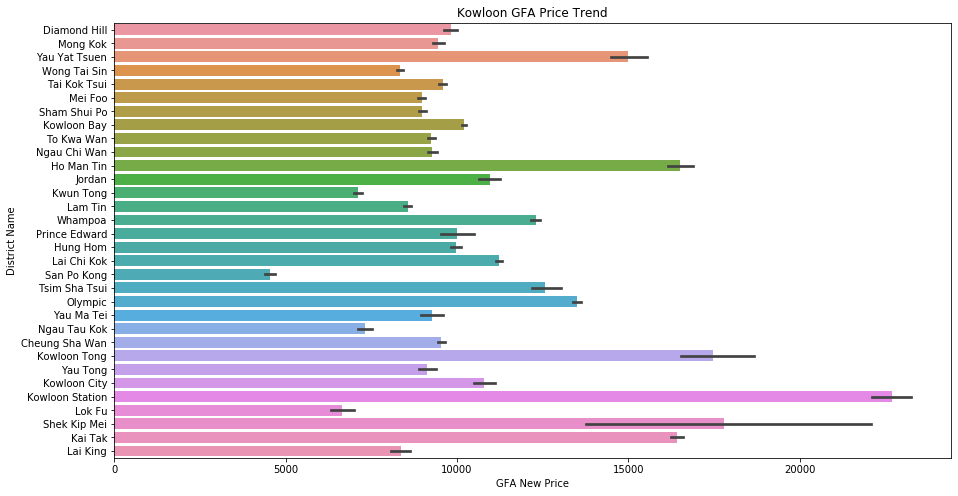

In [58]:
plt.figure(figsize=(15,8))
ax1 = sns.barplot(y="District Name",x="GFA New Price", data=kowloon).set_title("Kowloon GFA Price Trend")

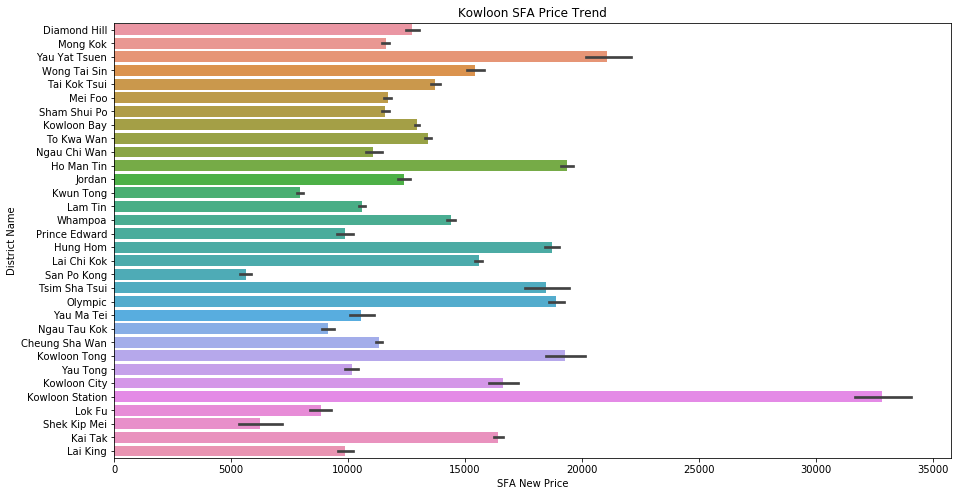

In [59]:
plt.figure(figsize=(15,8))
ax1 = sns.barplot(y="District Name",x="SFA New Price", 
                  data=kowloon).set_title("Kowloon SFA Price Trend")

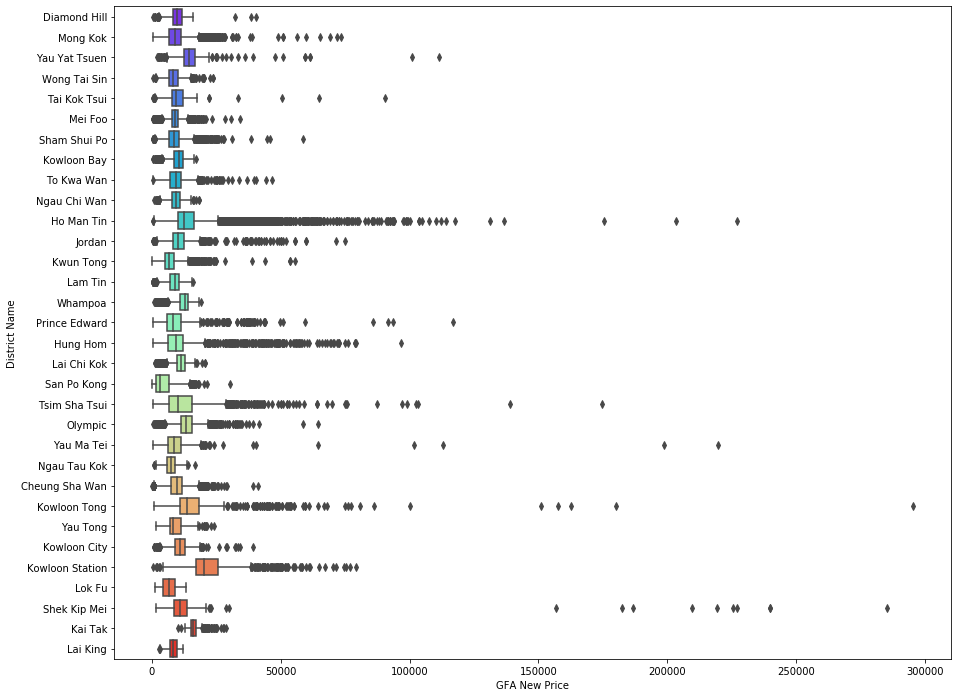

In [60]:
plt.figure(figsize=(15,12))
sns.boxplot(y='District Name',x='GFA New Price',data=kowloon,palette='rainbow')

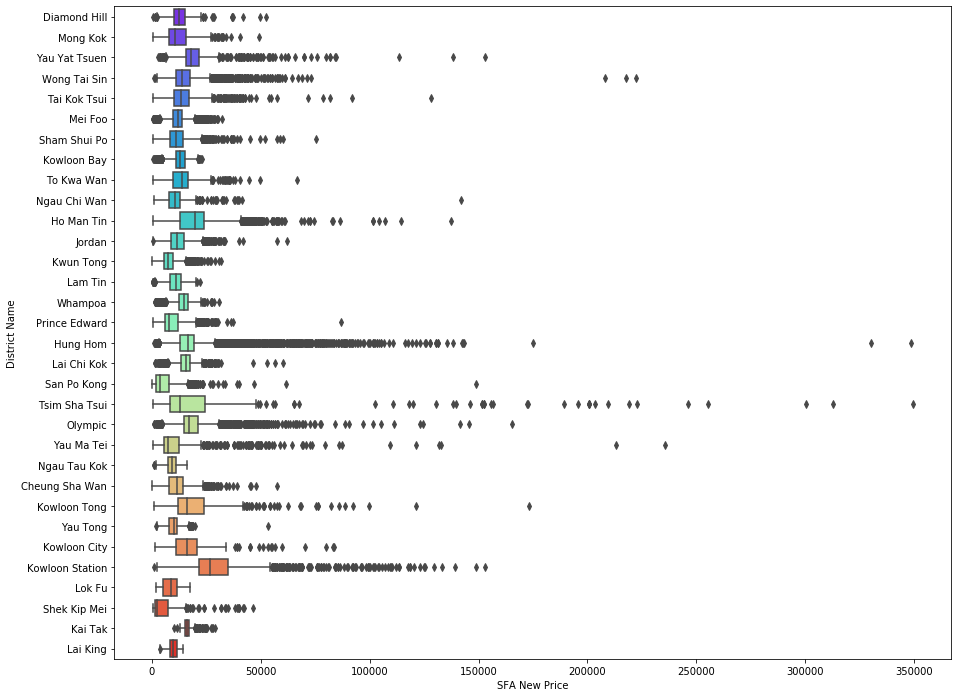

In [61]:
plt.figure(figsize=(15,12))
sns.boxplot(y='District Name',x='SFA New Price',data=kowloon,palette='rainbow')

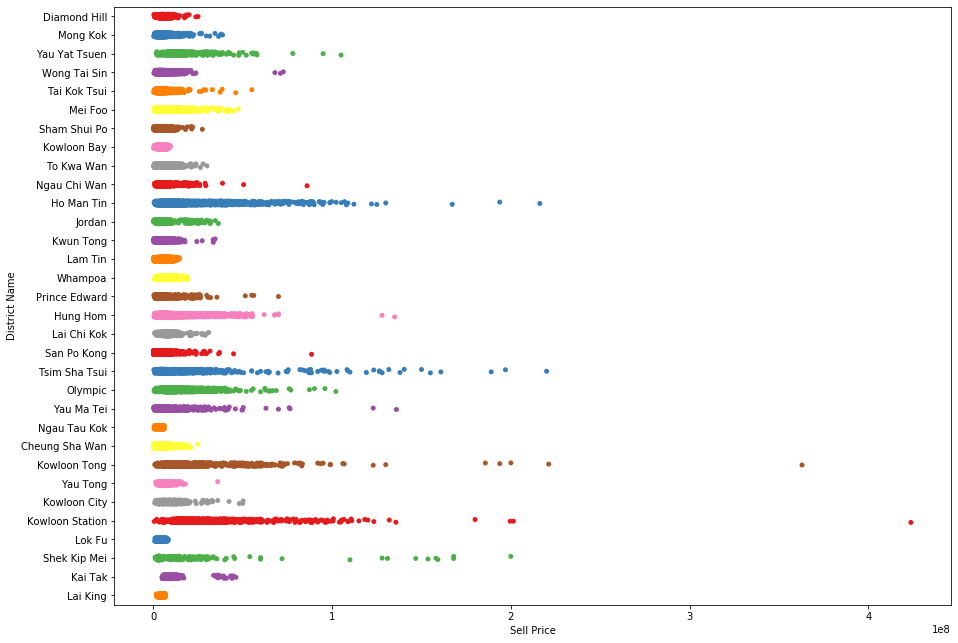

In [62]:
plt.figure(figsize=(15,11))
sns.stripplot(y="District Name",x="Sell Price",data=kowloon,jitter=True,palette='Set1')

In [63]:
kowloon.corr()

,Previous Transaction Flag,District ID,Estate ID,Sell Price,Hold Time (in days),Change flag,SFA,GFA,floor,SFA New Price,GFA New Price,Hold Time (in yrs)
Previous Transaction Flag,1.000000,0.020278,-0.369727,-0.040575,0.653984,0.933446,-0.014980,-0.018978,0.012909,-0.023961,-0.035847,0.653985
District ID,0.020278,1.000000,0.004647,0.002280,-0.001314,0.009730,-0.025060,0.004774,-0.004219,0.041055,0.013592,-0.001313
Estate ID,-0.369727,0.004647,1.000000,-0.015361,-0.315194,-0.397153,-0.082038,-0.086380,-0.000269,0.000689,0.012620,-0.315194
Sell Price,-0.040575,0.002280,-0.015361,1.000000,-0.015821,-0.023310,0.610253,0.649741,0.012408,0.760361,0.832724,-0.015821
Hold Time (in days),0.653984,-0.001314,-0.315194,-0.015821,1.000000,0.670704,0.062333,0.039163,0.008752,-0.043688,-0.035584,1.000000
Change flag,0.933446,0.009730,-0.397153,-0.023310,0.670704,1.000000,0.014462,-0.025467,0.013802,-0.021916,-0.005204,0.670705
SFA,-0.014980,-0.025060,-0.082038,0.610253,0.062333,0.014462,1.000000,0.594935,0.026065,0.116022,0.475267,0.062332
GFA,-0.018978,0.004774,-0.086380,0.649741,0.039163,-0.025467,0.594935,1.000000,0.014313,0.509176,0.251027,0.039163
floor,0.012909,-0.004219,-0.000269,0.012408,0.008752,0.013802,0.026065,0.014313,1.000000,-0.014402,-0.019299,0.008751
SFA New Price,-0.023961,0.041055,0.000689,0.760361,-0.043688,-0.021916,0.116022,0.509176,-0.014402,1.000000,0.652631,-0.043688


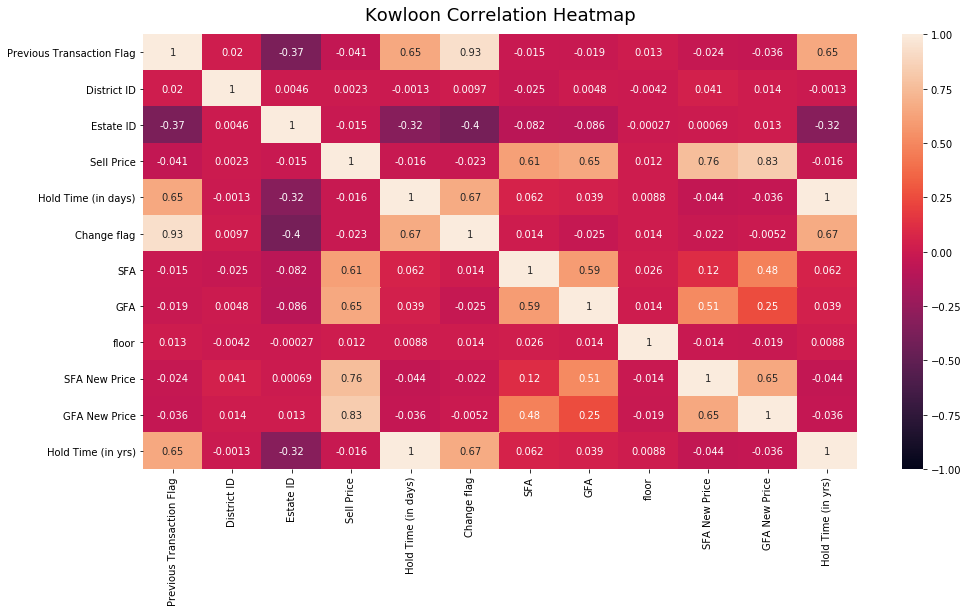

In [64]:
plt.figure(figsize=(16, 8))
heatmap = sns.heatmap(kowloon.corr(), vmin=-1, vmax=1, annot=True)
heatmap.set_title('Kowloon Correlation Heatmap', fontdict={'fontsize':18}, pad=14);

### Q3-B: Select 5 districts and visualize the trend of their property price


Text(0.5, 0, 'Date')

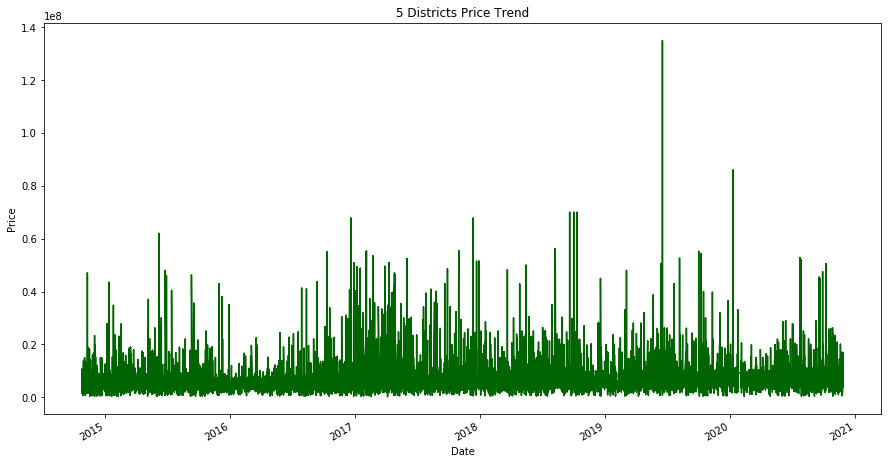

In [65]:
# Selected 5 Districts:
five_districts=pd.DataFrame(df2[df2['District Name'].isin(['To Kwa Wan',
                                       'Prince Edward',
                                       'Lam Tin',
                                      'Ngau Chi Wan',
                                      'Hung Hom'])],
                      columns= ['Sell Price',
                                'GFA New Price',
                                'SFA New Price',
                                'Hold Time (in days)',
                                'Hold Time (in yrs)',
                                'District Name',
                                'floor',
                                'Estate Name',
                                'Change flag'])
plt.figure(figsize=(15,8))
five_districts['Sell Price'].plot.line(color='darkgreen')
plt.title("5 Districts Price Trend")
plt.ylabel("Price")
plt.xlabel("Date")

In [66]:
import plotly.express as px
import pandas as pd

# Reset index on original dataframe to include "date" as a column and part of DF to chart dates as "x"
new_df=five_districts.copy()
new_df1=new_df.reset_index()
new_df1.columns=["data",'Sell Price',
                                'GFA New Price',
                                'SFA New Price',
                                'Hold Time (in days)',
                                'Hold Time (in yrs)',
                                'District Name',
                                'floor',
                                'Estate Name',
                                'Change flag']

# Interactive Chart with date slider at the bottom
df = new_df1
fig = px.line(df,x="data", y='Sell Price', title='Sell Price for 5 Districts with Rangeslider')
fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()

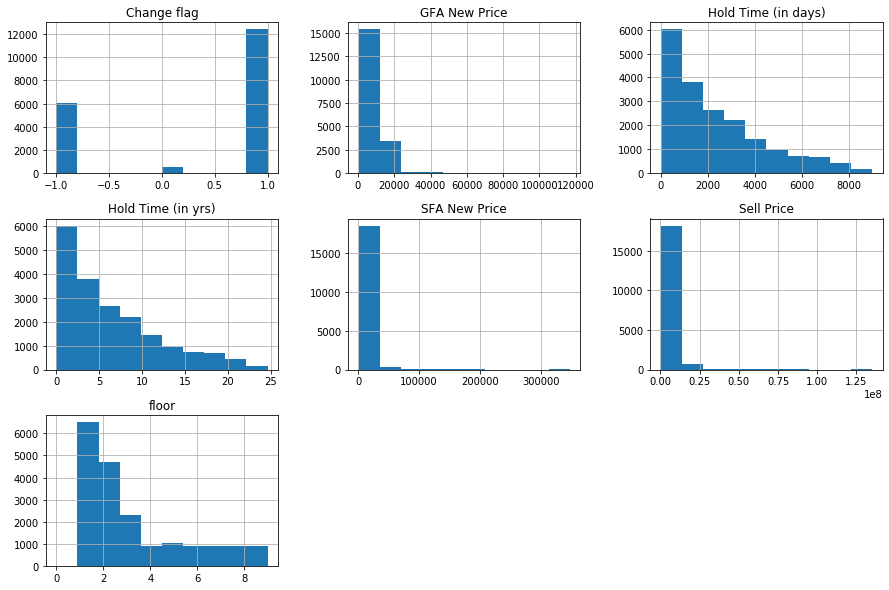

In [67]:
# Pandas Hist function
five_districts.hist(bins=10 , figsize=(15,10)) #Pandas Hist function
plt.show()

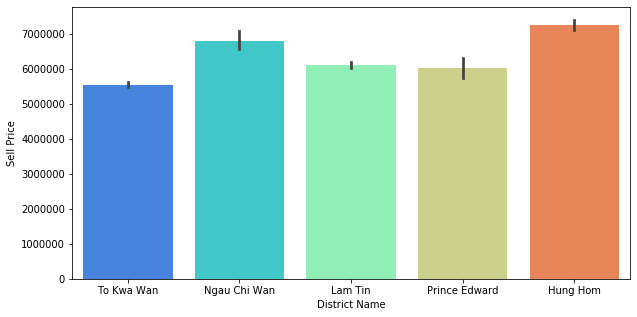

In [68]:
plt.figure(figsize=(10,5))
sns.barplot(x='District Name',y='Sell Price',data=five_districts,palette='rainbow')

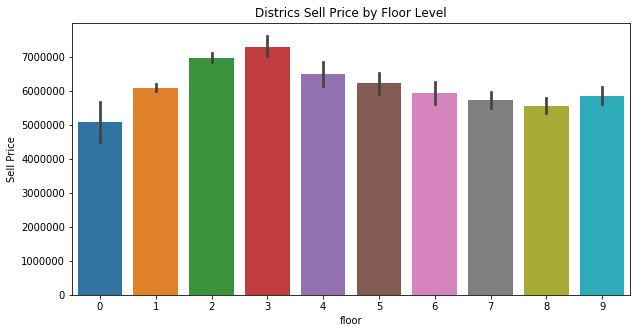

In [69]:
plt.figure(figsize=(10,5))
ax1 = sns.barplot(x="floor",y="Sell Price", 
                  data=five_districts).set_title("Districs Sell Price by Floor Level")

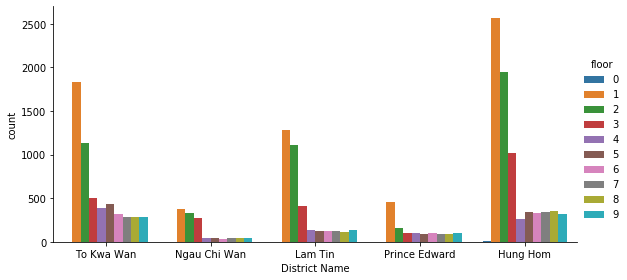

In [70]:
# Sell price by Floor by District and floor
g = sns.catplot(x="District Name", hue='floor', data=five_districts, kind="count",height=4, aspect=2)

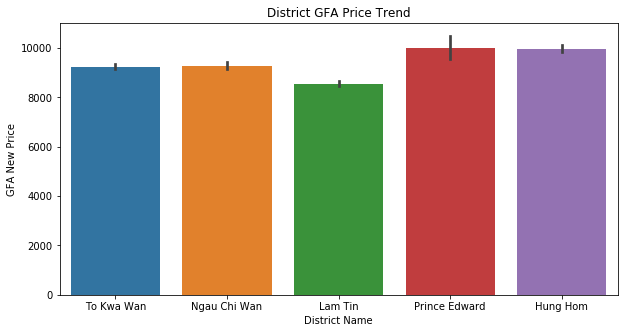

In [71]:
plt.figure(figsize=(10,5))
ax1 = sns.barplot(x="District Name",y="GFA New Price", 
                  data=five_districts).set_title("District GFA Price Trend")

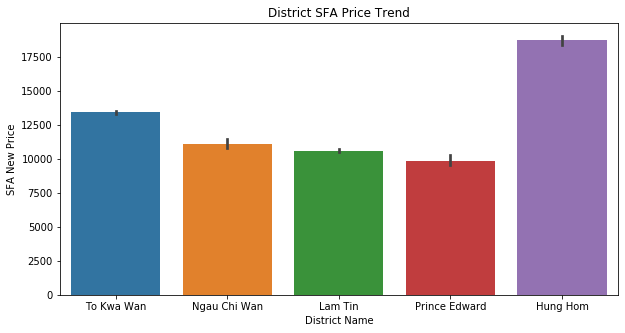

In [72]:
plt.figure(figsize=(10,5))
ax1 = sns.barplot(x="District Name",y="SFA New Price", 
                  data=five_districts).set_title("District SFA Price Trend")

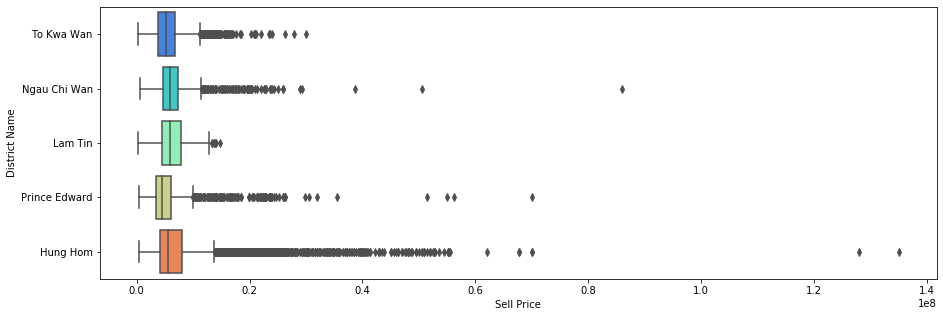

In [73]:
plt.figure(figsize=(15,5))
sns.boxplot(x='Sell Price',y='District Name',data=five_districts,palette='rainbow')

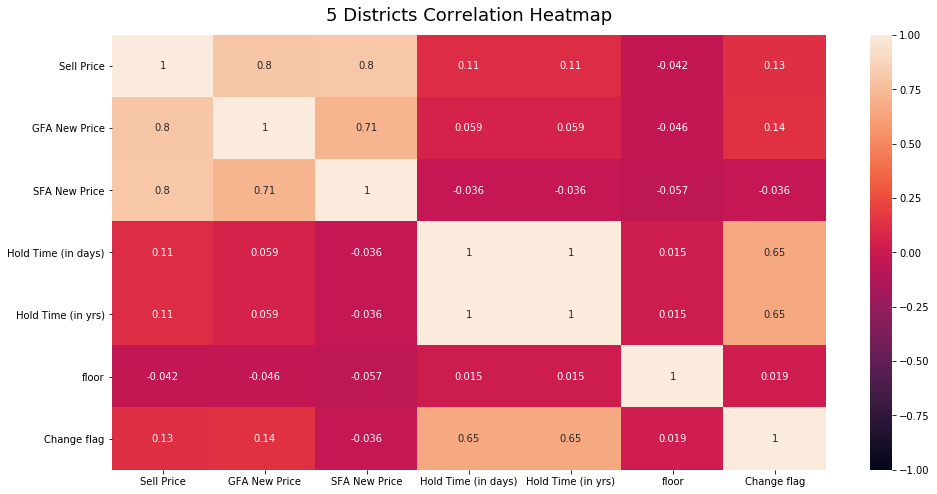

In [74]:
plt.figure(figsize=(16, 8))
heatmap = sns.heatmap(five_districts.corr(), vmin=-1, vmax=1, annot=True)
heatmap.set_title('5 Districts Correlation Heatmap', fontdict={'fontsize':18}, pad=14);

### Q3-C: Select 10 estates and visualize the trend of their property price

Text(0.5, 0, 'Date')

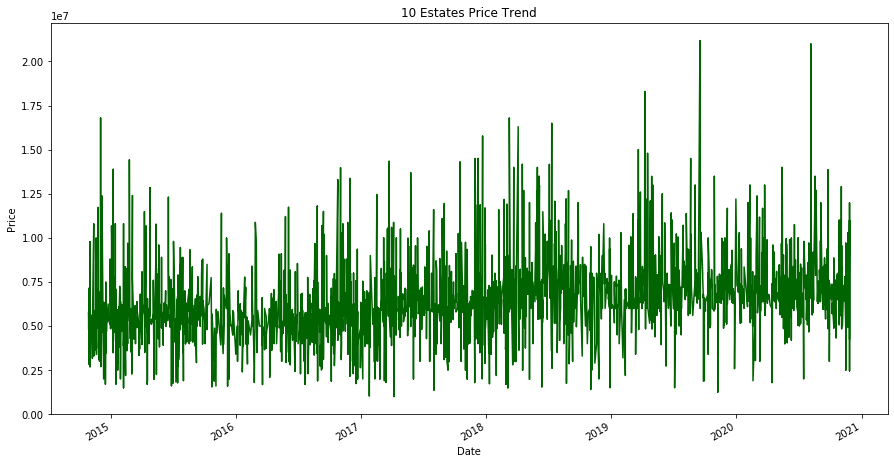

In [75]:
# Selected 10 Estates:
ten_estates=pd.DataFrame(df2[df2['Estate Name'].isin(['Fa Yuen Plaza','Caldecott Hill','Pang Ching Court',
                                                        'Metro Harbour View','Nob Hill','Chi Fung Court',
                                                        'Telford Garden','Tsui Chuk Garden','Grand waterfront',
                                                        'Dragon View'])],
                      columns= ['Sell Price',
                                'GFA New Price',
                                'SFA New Price',
                                'Hold Time (in days)',
                                'Hold Time (in yrs)',
                                'District Name',
                                'Estate Name', 
                                'floor',
                                'Change flag'])
plt.figure(figsize=(15,8))
ten_estates['Sell Price'].plot.line(color='darkgreen')
plt.title("10 Estates Price Trend")
plt.ylabel("Price")
plt.xlabel("Date")

In [76]:
import plotly.express as px
import pandas as pd

# Reset index on original dataframe to include "date" as a column and part of DF to chart dates as "x"
new_df=ten_estates.copy()
new_df1=new_df.reset_index()
new_df1.columns=["data","Sell Price","GFA New Price","SFA New Price",
                 "Hold Time (in days)","District Name",
                 "Estate Name","floor",'Hold Time (in yrs)','Change flag']

# Interactive Chart with date slider at the bottom
df = new_df1
fig = px.line(df,x="data", y='Sell Price', title='Sell Price for 10 Estates with Rangeslider')
fig.update_xaxes(
    rangeslider_visible=True,
    rangeselector=dict(
        buttons=list([
            dict(count=1, label="m", step="month", stepmode="backward"),
            dict(count=6, label="6m", step="month", stepmode="backward"),
            dict(count=1, label="YTD", step="year", stepmode="todate"),
            dict(count=1, label="1y", step="year", stepmode="backward"),
            dict(step="all")
        ])
    )
)
fig.show()

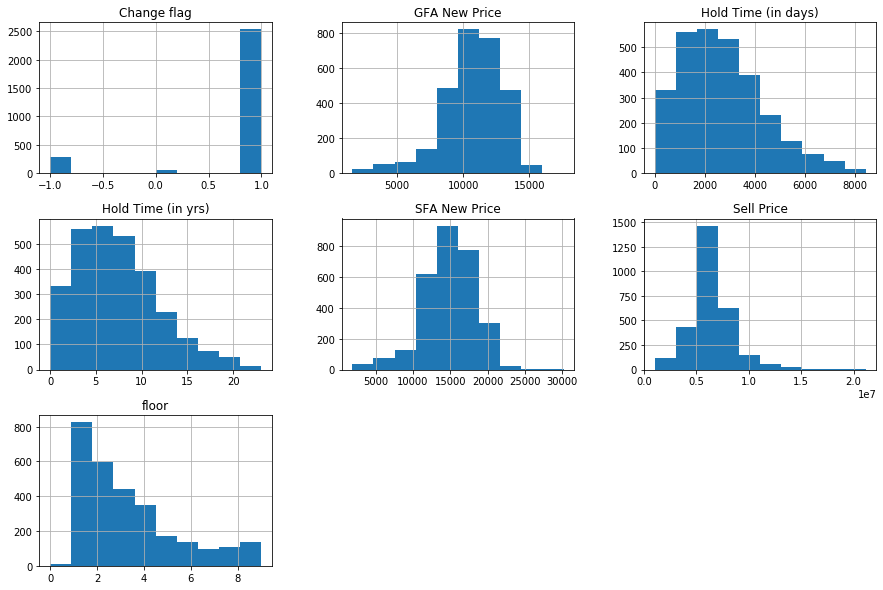

In [77]:
# Pandas Hist function
ten_estates.hist(bins=10 , figsize=(15,10)) #Pandas Hist function
plt.show()

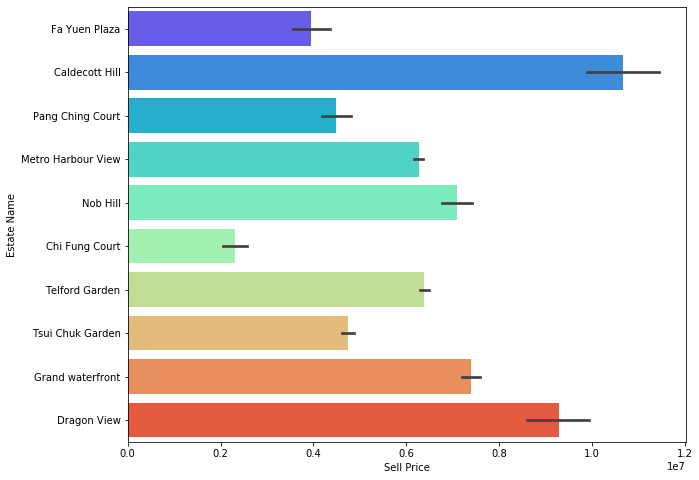

In [78]:
plt.figure(figsize=(10,8))
sns.barplot(y='Estate Name',x='Sell Price',data=ten_estates,palette='rainbow')

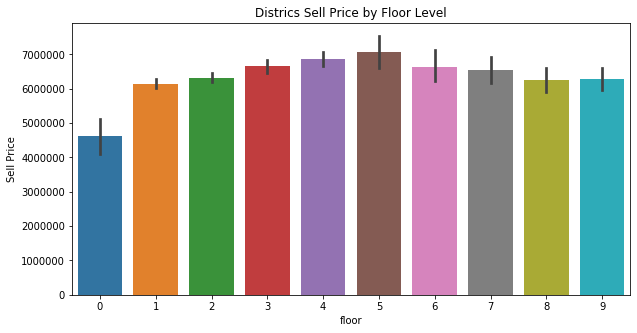

In [79]:
plt.figure(figsize=(10,5))
ax1 = sns.barplot(x="floor",y="Sell Price", 
                  data=ten_estates).set_title("Districs Sell Price by Floor Level")

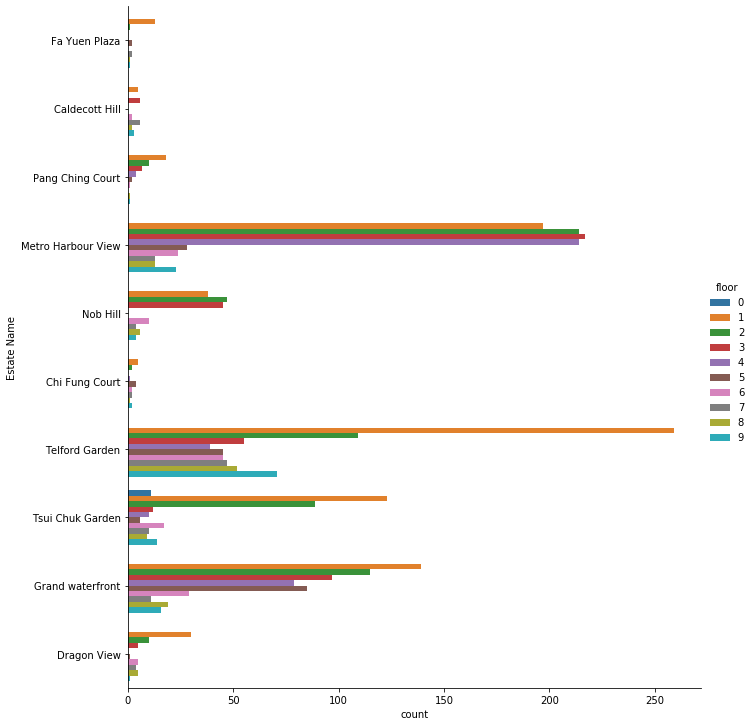

In [80]:
# Sell price by Floor by Estate and by Profit, Lost, and no previous transactions

g = sns.catplot(y="Estate Name", hue='floor',  
                   data=ten_estates, 
                   kind="count",
               height=10, aspect=1)

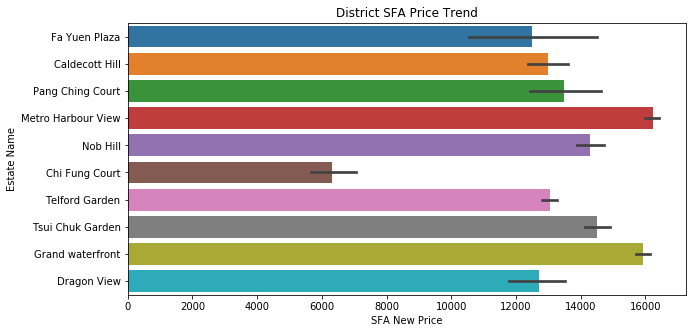

In [81]:
plt.figure(figsize=(10,5))
ax1 = sns.barplot(y="Estate Name",x="SFA New Price", 
                  data=ten_estates).set_title("District SFA Price Trend")

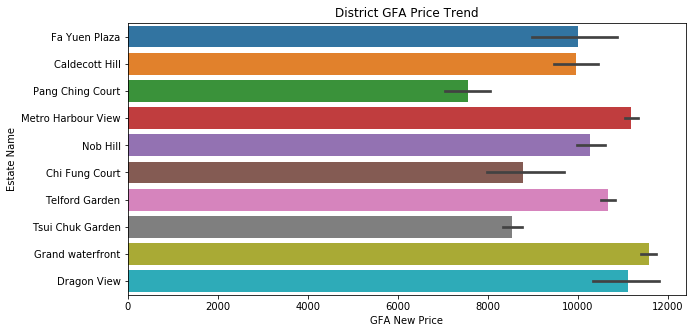

In [82]:
plt.figure(figsize=(10,5))
ax1 = sns.barplot(y="Estate Name",x="GFA New Price", 
                  data=ten_estates).set_title("District GFA Price Trend")

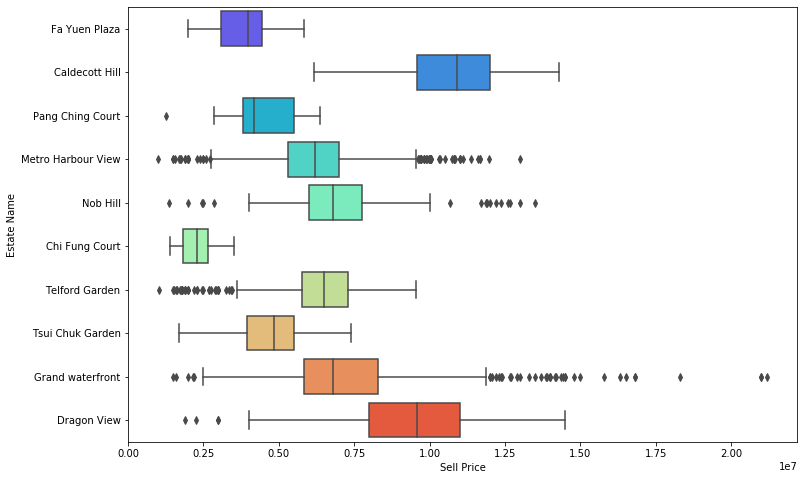

In [83]:
plt.figure(figsize=(12,8))
sns.boxplot(x='Sell Price',y='Estate Name',data=ten_estates,palette='rainbow')

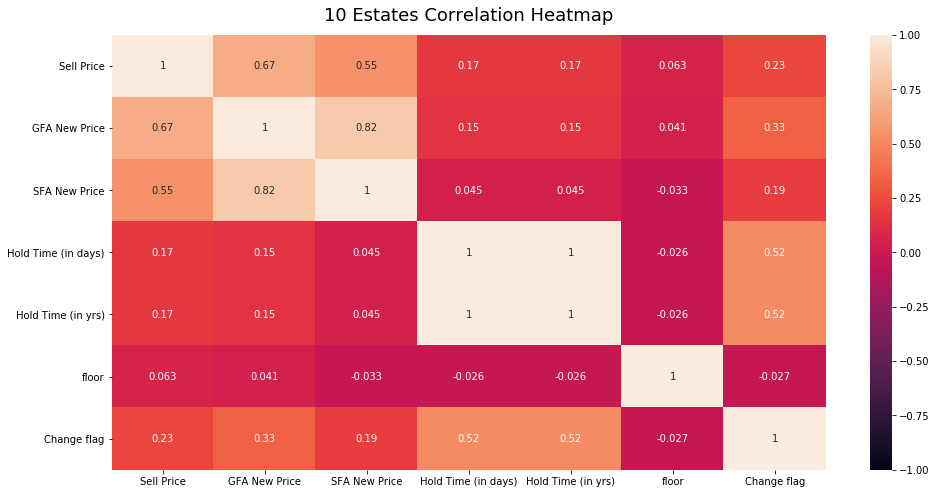

In [84]:
plt.figure(figsize=(16, 8))
heatmap = sns.heatmap(ten_estates.corr(), vmin=-1, vmax=1, annot=True)
heatmap.set_title('10 Estates Correlation Heatmap', fontdict={'fontsize':18}, pad=14);

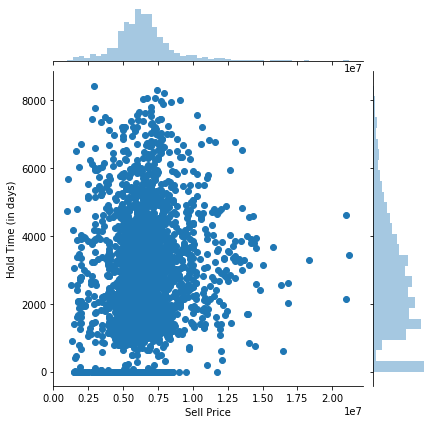

In [85]:
sns.jointplot(data=ten_estates, x="Sell Price", y="Hold Time (in days)")

# Learning model

Apply any statistical learning / machine learning to determine what kind of factors impact the property price (distirct? area? floor?), which should include training vs testing data split, training model, evaluating the model.

In [86]:
# Create correlation heatmap in order to select variables for the liner model (OLS)

# We can see Sell Price is posiively correlated to: SFA, GFA, SFA Price, GFA Price
# There is high correlation between GFA and SFA, Change Flag and Hold Time, etc.
# Hence we need to avoid using highly correlated variables in the regression model in order to avoid collinearity problem/s

corr = base_data.corr()
plt.figure(figsize=(10, 5))
corr.style.background_gradient(cmap = "viridis").set_precision(2)

,Previous Transaction Flag,District ID,Estate ID,Sell Price,Hold Time (in days),Change flag,SFA,GFA,floor,SFA New Price,GFA New Price,Hold Time (in yrs),year,month,quarter
Previous Transaction Flag,1.00,0.02,-0.37,-0.04,0.65,0.93,-0.01,-0.02,0.01,-0.02,-0.04,0.65,0.20,-0.05,-0.04
District ID,0.02,1.00,0.00,0.00,-0.00,0.01,-0.03,0.00,-0.00,0.04,0.01,-0.00,-0.01,-0.01,-0.01
Estate ID,-0.37,0.00,1.00,-0.02,-0.32,-0.40,-0.08,-0.09,-0.00,0.00,0.01,-0.32,-0.03,0.01,0.01
Sell Price,-0.04,0.00,-0.02,1.00,-0.02,-0.02,0.61,0.65,0.01,0.76,0.83,-0.02,0.07,0.00,0.00
Hold Time (in days),0.65,-0.00,-0.32,-0.02,1.00,0.67,0.06,0.04,0.01,-0.04,-0.04,1.00,0.21,-0.02,-0.02
Change flag,0.93,0.01,-0.40,-0.02,0.67,1.00,0.01,-0.03,0.01,-0.02,-0.01,0.67,0.17,-0.02,-0.02
SFA,-0.01,-0.03,-0.08,0.61,0.06,0.01,1.00,0.59,0.03,0.12,0.48,0.06,0.02,-0.01,-0.01
GFA,-0.02,0.00,-0.09,0.65,0.04,-0.03,0.59,1.00,0.01,0.51,0.25,0.04,0.00,-0.00,0.00
floor,0.01,-0.00,-0.00,0.01,0.01,0.01,0.03,0.01,1.00,-0.01,-0.02,0.01,0.00,0.00,0.00
SFA New Price,-0.02,0.04,0.00,0.76,-0.04,-0.02,0.12,0.51,-0.01,1.00,0.65,-0.04,0.10,0.01,0.01


<Figure size 720x360 with 0 Axes>

In [87]:
# Design Multiple Linear Regression (MLR)

from sklearn.linear_model import LinearRegression
model1=base_data[['District ID', 'Estate ID','SFA',
                  'SFA New Price','Hold Time (in days)',
                  'floor','year', 'quarter','Sell Price']]

In [88]:
# Check model
model1.head()

,District ID,Estate ID,SFA,SFA New Price,Hold Time (in days),floor,year,quarter,Sell Price
0,79,2058,657.0,15221.0,6091,2,2020,4,10000000
1,71,2712,214.0,20000.0,1080,1,2020,4,4280000
2,78,3094,991.0,11100.0,2044,7,2020,4,11000000
3,57,5035,327.0,14986.0,0,1,2020,4,4900000
4,67,2564,412.0,17354.0,4537,1,2020,4,7150000


In [89]:
# Assign "x" and "y"
X = model1.iloc[:, :-1].values
y = model1.iloc[:, -1].values

In [90]:
# Split data 80:20
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.2, random_state = 0)

In [91]:
# Run OLS Model
# The R-squared score is high and the AIC and BIC is very low indicating we have a good model
# The OLS model can explain 85% of the variability in Sell Price

import statsmodels.api as sm
X_train = sm.add_constant(X_train)
model = sm.OLS(y_train, X_train, missing = 'drop')
results = model.fit()
results.summary(xname=['Constant','District ID', 'Estate ID','SFA',
                       'SFA New Price','Hold Time (in days)',
                       'floor','year','quarter'])

<class 'statsmodels.iolib.summary.Summary'>
"""
                            OLS Regression Results                            
==============================================================================
Dep. Variable:                      y   R-squared:                       0.856
Model:                            OLS   Adj. R-squared:                  0.856
Method:                 Least Squares   F-statistic:                 4.769e+04
Date:                Mon, 21 Dec 2020   Prob (F-statistic):               0.00
Time:                        00:16:20   Log-Likelihood:            -1.0509e+06
No. Observations:               64000   AIC:                         2.102e+06
Df Residuals:                   63991   BIC:                         2.102e+06
Df Model:                           8                                         
Covariance Type:            nonrobust                                         
=======================================================================================
                          coef    std err          t      P>|t|      [0.025      0.975]
---------------------------------------------------------------------------------------
Constant             9.908e+07   1.55e+07      6.403      0.000    6.88e+07    1.29e+08
District ID         -9099.1425    997.523     -9.122      0.000   -1.11e+04   -7143.997
Estate ID              48.6701      3.069     15.857      0.000      42.654      54.686
SFA                  1.965e+04     56.840    345.674      0.000    1.95e+04    1.98e+04
SFA New Price         623.9307      1.344    464.137      0.000     621.296     626.566
Hold Time (in days)   -30.4534      6.576     -4.631      0.000     -43.342     -17.565
floor                3.136e+04   5249.374      5.973      0.000    2.11e+04    4.16e+04
year                -5.462e+04   7671.460     -7.119      0.000   -6.97e+04   -3.96e+04
quarter             -4769.7152   1.19e+04     -0.402      0.688    -2.8e+04    1.85e+04
==============================================================================
Omnibus:                   146085.179   Durbin-Watson:                   1.998
Prob(Omnibus):                  0.000   Jarque-Bera (JB):       6382908699.908
Skew:                          21.233   Prob(JB):                         0.00
Kurtosis:                    1549.540   Cond. No.                     2.14e+07
==============================================================================

Warnings:
[1] Standard Errors assume that the covariance matrix of the errors is correctly specified.
[2] The condition number is large, 2.14e+07. This might indicate that there are
strong multicollinearity or other numerical problems.
"""

# Data Analysis

### Part I: Lets analyse our "base dataset" for Kowloon

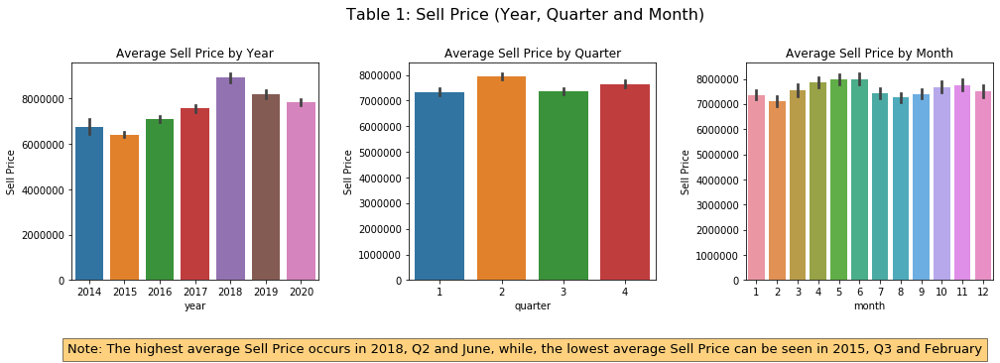

In [92]:
# Sales Price Trend (Year, Quarter and Month)
fig, ax =plt.subplots(1,3,figsize=(15,5))
fig. tight_layout(pad=6.0)
sns.barplot(x="year",y="Sell Price",data=base_data,ax=ax[0]).set_title("Average Sell Price by Year")
sns.barplot(x="quarter",y="Sell Price",data=base_data,ax=ax[1]).set_title("Average Sell Price by Quarter")
sns.barplot(x="month",y="Sell Price",data=base_data,ax=ax[2]).set_title("Average Sell Price by Month")
fig.suptitle('Table 1: Sell Price (Year, Quarter and Month)',fontsize=16)
plt.figtext(0.5, 0.01, "Note: The highest average Sell Price occurs in 2018, Q2 and June, while, the lowest average Sell Price can be seen in 2015, Q3 and February", ha="center", fontsize=13, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})
fig.show()

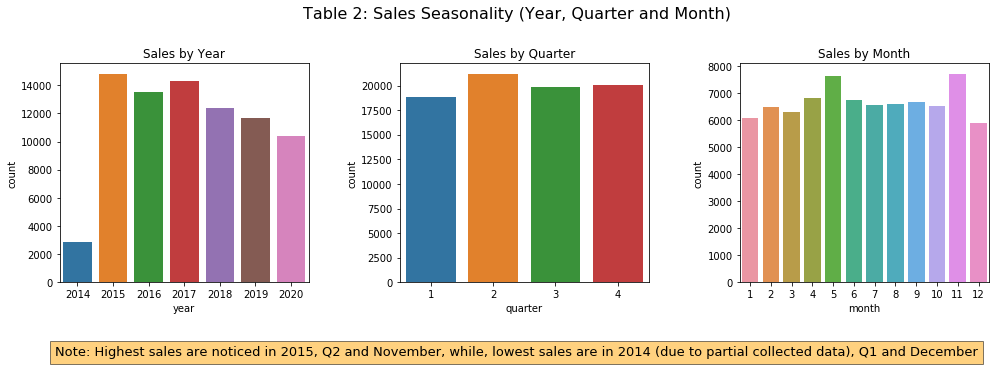

In [93]:
# Sales seasonality (Year, Quarter and Month)
fig, ax =plt.subplots(1,3,figsize=(15,5))
fig. tight_layout(pad=6.0)
sns.countplot(x="year", data=base_data, ax=ax[0]).set_title("Sales by Year")
sns.countplot(x="quarter", data=base_data, ax=ax[1]).set_title("Sales by Quarter")
sns.countplot(x="month", data=base_data,ax=ax[2]).set_title("Sales by Month")
fig.suptitle('Table 2: Sales Seasonality (Year, Quarter and Month)',fontsize=16)
plt.figtext(0.5, 0.01, "Note: Highest sales are noticed in 2015, Q2 and November, while, lowest sales are in 2014 (due to partial collected data), Q1 and December", ha="center", fontsize=13, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})
fig.show()

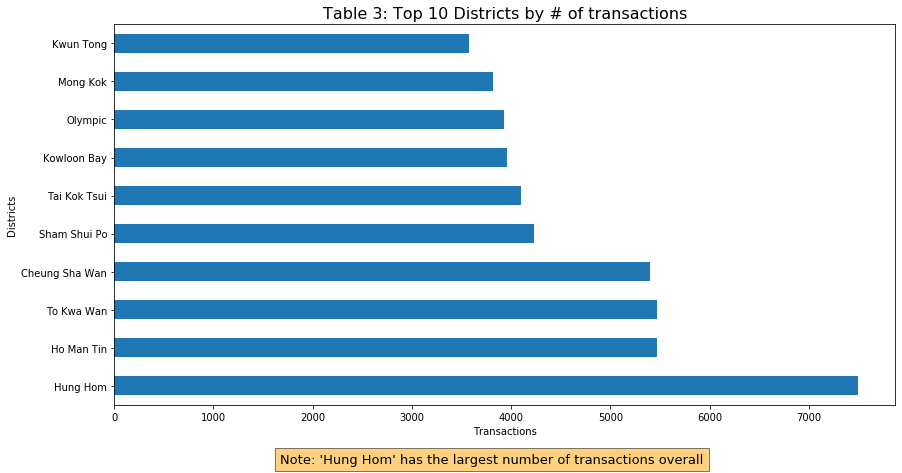

In [94]:
# Top 10 Districts
top_district=base_data['District Name'].value_counts()
plt.figure(figsize=(14,7))
top_district.iloc[:10].plot(kind="barh")
plt.xlabel('Transactions')
plt.ylabel('Districts')
plt.title('Table 3: Top 10 Districts by # of transactions',fontsize=16)
plt.figtext(0.5, 0.01, "Note: 'Hung Hom' has the largest number of transactions overall", ha="center", fontsize=13, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})
fig.show()

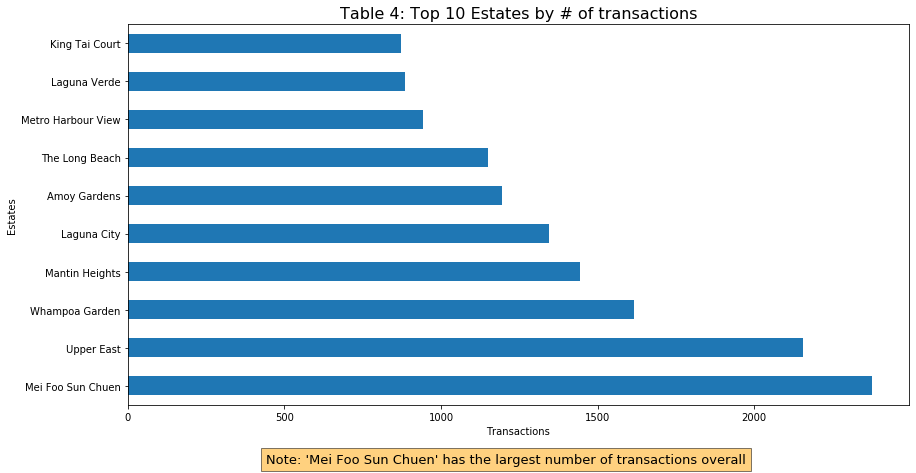

In [95]:
# Top 10 Estates
top_estate=base_data['Estate Name'].value_counts()
plt.figure(figsize=(14,7))
top_estate.iloc[:10].plot(kind="barh")
plt.xlabel('Transactions')
plt.ylabel('Estates')
plt.title('Table 4: Top 10 Estates by # of transactions',fontsize=16)
plt.figtext(0.5, 0.01, "Note: 'Mei Foo Sun Chuen' has the largest number of transactions overall", ha="center", fontsize=13, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})
fig.show()

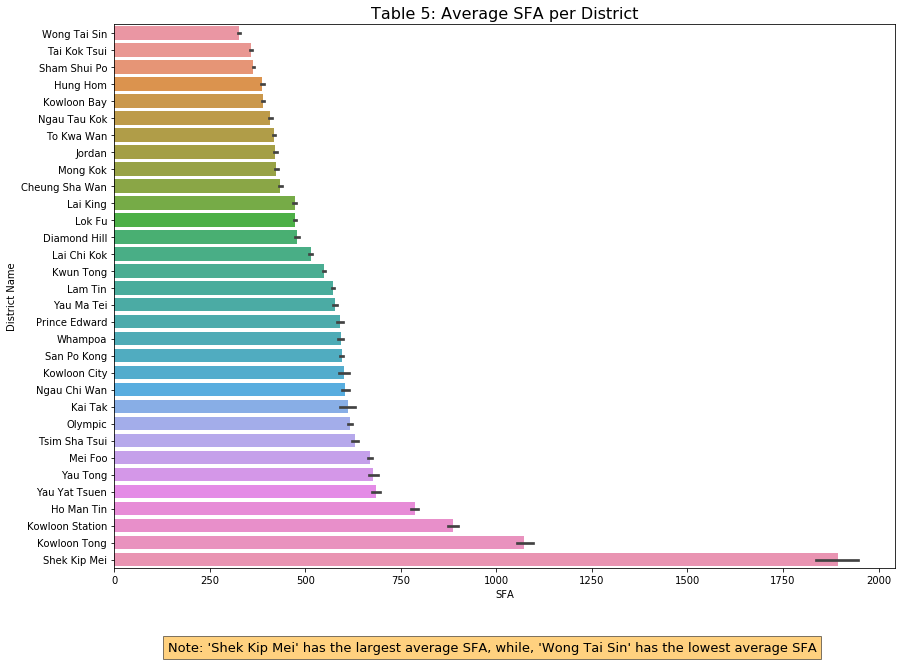

In [96]:
# Average SFA per District
plt.figure(figsize=(14,10))
result = base_data.groupby(["District Name"])['SFA'].aggregate(np.mean).reset_index().sort_values('SFA')
sns.barplot(x='SFA', y="District Name", data=base_data, order=result['District Name'])
plt.title('Table 5: Average SFA per District',fontsize=16)
plt.figtext(0.5, 0.01, "Note: 'Shek Kip Mei' has the largest average SFA, while, 'Wong Tai Sin' has the lowest average SFA", ha="center", fontsize=13, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})
fig.show()

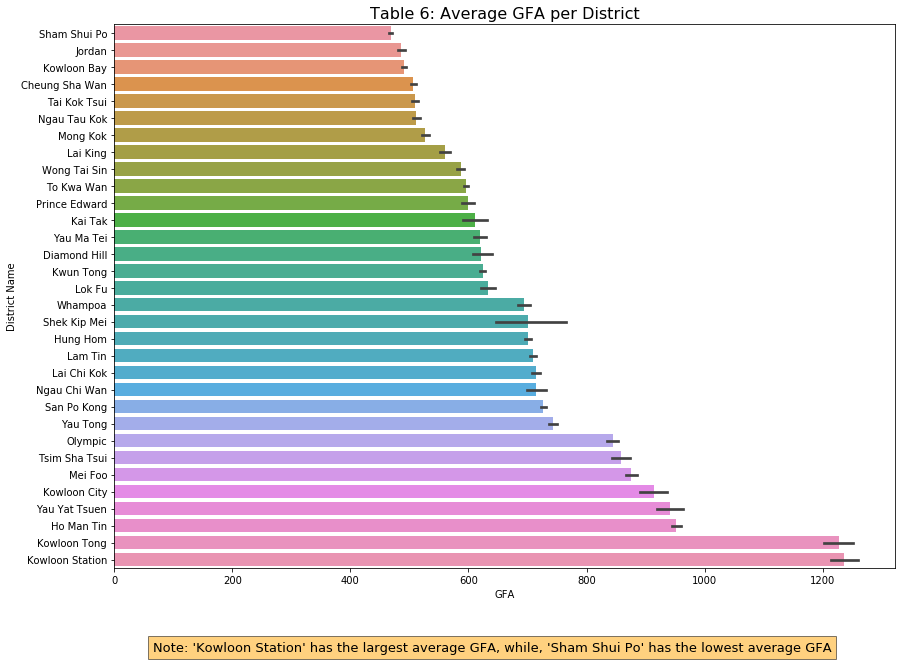

In [97]:
# Average GFA per District
plt.figure(figsize=(14,10))
result1 = base_data.groupby(["District Name"])['GFA'].aggregate(np.mean).reset_index().sort_values('GFA')
sns.barplot(x='GFA', y="District Name", data=base_data, order=result1['District Name'])
plt.title('Table 6: Average GFA per District',fontsize=16)
plt.figtext(0.5, 0.01, "Note: 'Kowloon Station' has the largest average GFA, while, 'Sham Shui Po' has the lowest average GFA", ha="center", fontsize=13, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})
fig.show()

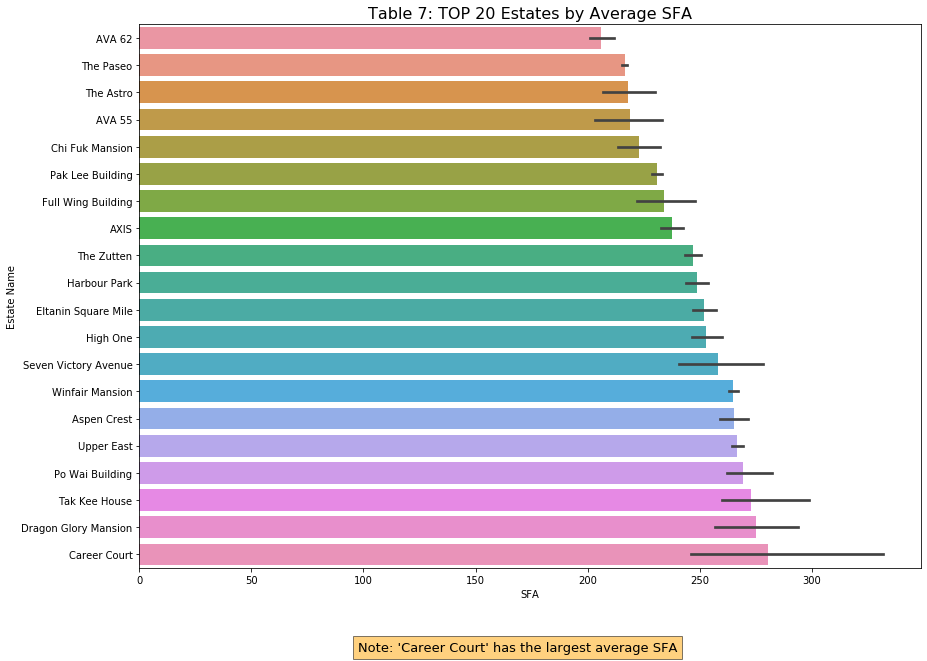

In [98]:
# Top 20 Estates by Average SFA
plt.figure(figsize=(14,10))
result3 = base_data.groupby(["Estate Name"])['SFA'].aggregate(np.mean).reset_index().sort_values('SFA').iloc[:20]
sns.barplot(x='SFA', y="Estate Name", data=base_data, order=result3['Estate Name'])
plt.title('Table 7: TOP 20 Estates by Average SFA',fontsize=16)
plt.figtext(0.5, 0.01, "Note: 'Career Court' has the largest average SFA", ha="center", fontsize=13, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})
fig.show()

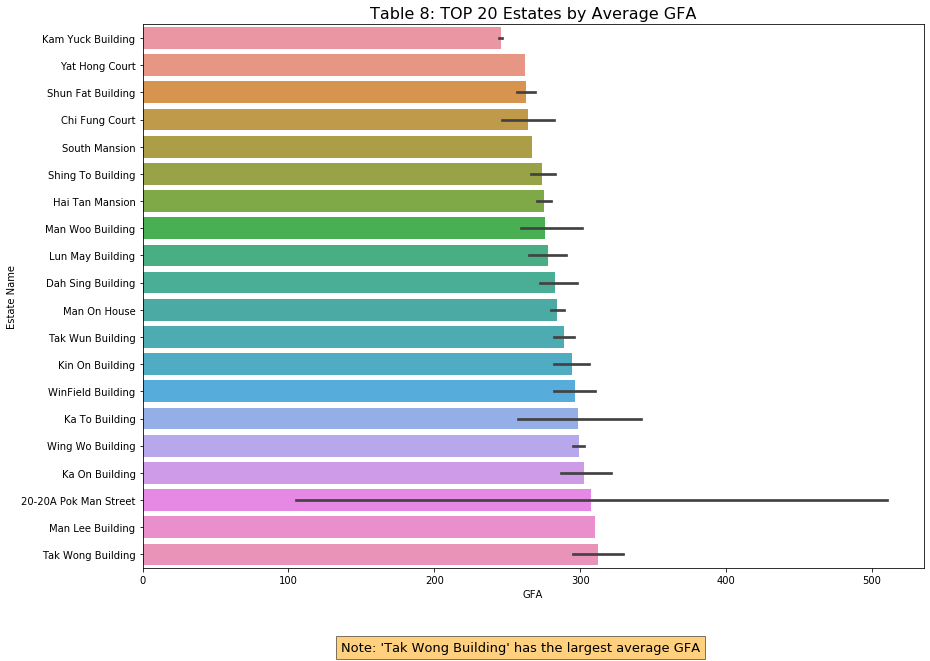

In [99]:
# Top 20 Estates by Average GFA
plt.figure(figsize=(14,10))
result3 = base_data.groupby(["Estate Name"])['GFA'].aggregate(np.mean).reset_index().sort_values('GFA').iloc[:20]
sns.barplot(x='GFA', y="Estate Name", data=base_data, order=result3['Estate Name'])
plt.title('Table 8: TOP 20 Estates by Average GFA',fontsize=16)
plt.figtext(0.5, 0.01, "Note: 'Tak Wong Building' has the largest average GFA", ha="center", fontsize=13, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})
fig.show()

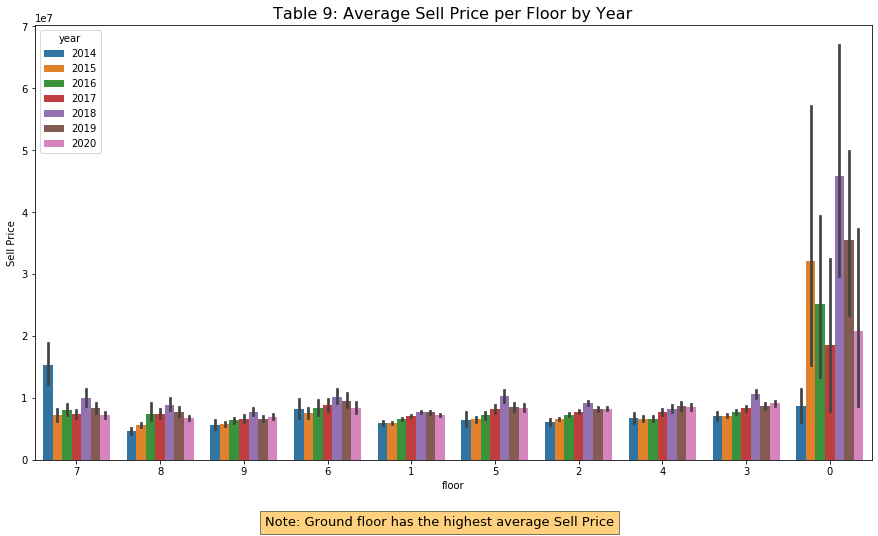

In [100]:
# Average Sell Price per Floor by Year
plt.figure(figsize=(15,8))
result5 = base_data.groupby(["floor"])['Sell Price'].aggregate(np.median).reset_index().sort_values('Sell Price')
sns.barplot(y='Sell Price', x="floor", hue="year", data=base_data, order=result5['floor'])
plt.title('Table 9: Average Sell Price per Floor by Year',fontsize=16)
plt.figtext(0.5, 0.01, "Note: Ground floor has the highest average Sell Price", ha="center", fontsize=13, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})
fig.show()

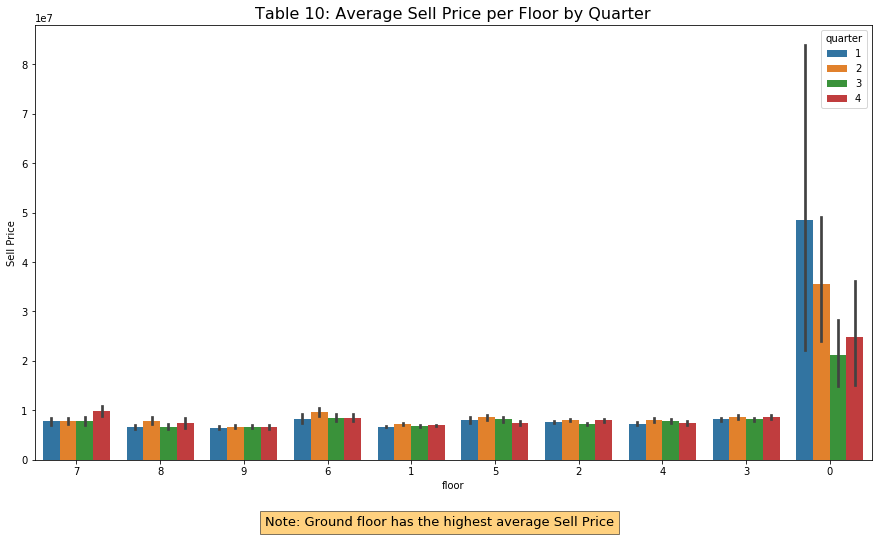

In [101]:
# Average Sell Price per Floor by Quarter
plt.figure(figsize=(15,8))
result5 = base_data.groupby(["floor"])['Sell Price'].aggregate(np.median).reset_index().sort_values('Sell Price')
sns.barplot(y='Sell Price', x="floor", hue="quarter", data=base_data, order=result5['floor'])
plt.title('Table 10: Average Sell Price per Floor by Quarter',fontsize=16)
plt.figtext(0.5, 0.01, "Note: Ground floor has the highest average Sell Price", ha="center", fontsize=13, bbox={"facecolor":"orange", "alpha":0.5, "pad":5})
fig.show()

### Part II: Lets analyse our "blend dataset" (kawloon dataset + economic dataset as per Q1-B)

In [102]:
# Interactive Chart: Total Sales by District by GDP and Hold Time

import plotly.express as px

fig = px.scatter(blend_data, x="GDP Per Capita", y="Hold Time (in yrs)",
                 size="Sell Price", color="Sell Price",
                 hover_name="District Name", log_x=True, size_max=60, 
                 title='Table 11: Interactive Chart - Total Sales by District by GDP and Hold Time')

fig.show()

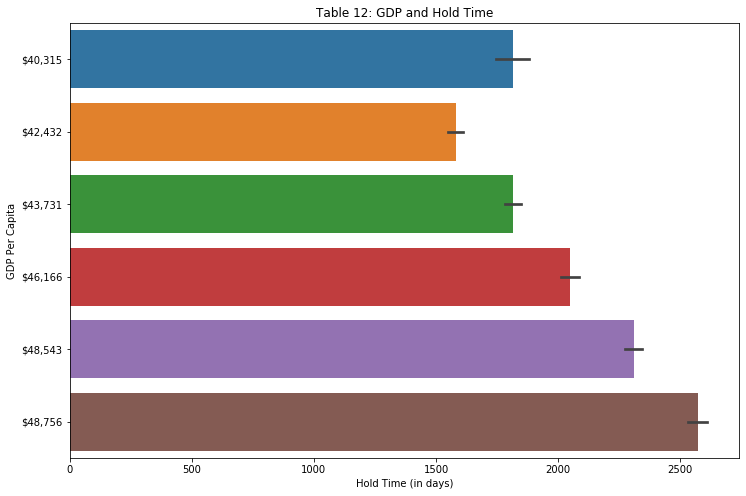

In [103]:
# GDP and Hold Time
plt.figure(figsize=(12,8))
ax1 = sns.barplot(y="GDP Per Capita",x='Hold Time (in days)', 
                  data=blend_data).set_title("Table 12: GDP and Hold Time")

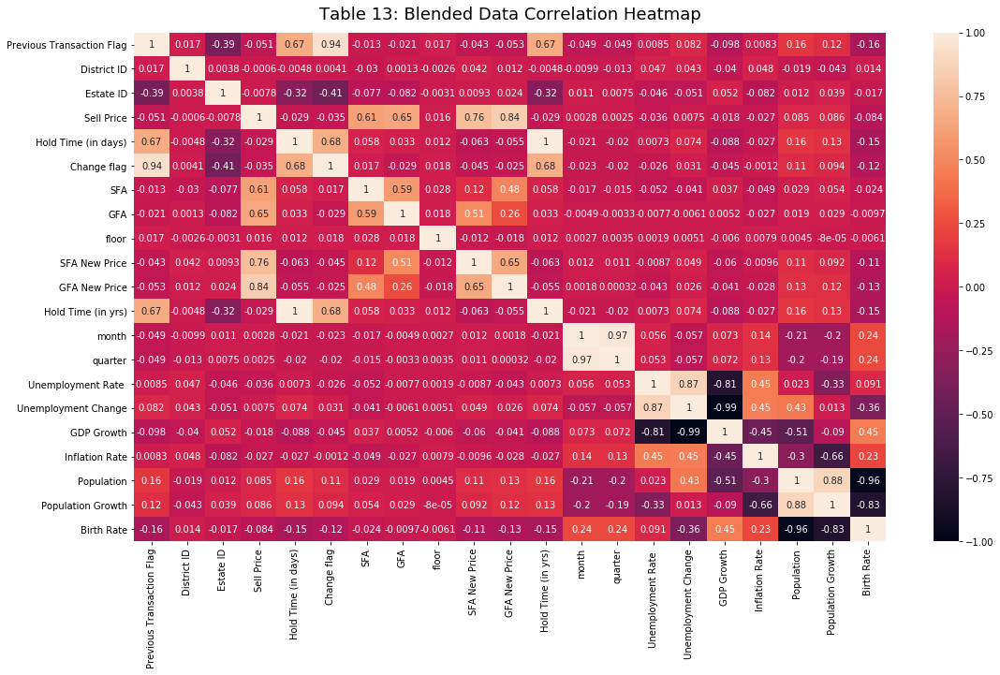

In [104]:
plt.figure(figsize=(18, 10))
heatmap = sns.heatmap(blend_data.corr(), vmin=-1, vmax=1, annot=True)
heatmap.set_title('Table 13: Blended Data Correlation Heatmap', fontdict={'fontsize':18}, pad=14);